In [3]:
# Initialize Otter
import otter
grader = otter.Notebook("hw2-seda.ipynb")

In [4]:
import numpy as np
import pandas as pd
import altair as alt
# disable row limit for plotting
alt.data_transformers.disable_max_rows()
# uncomment to ensure graphics display with pdf export
alt.renderers.enable('mimetype')

RendererRegistry.enable('mimetype')

# Background 

Gender achievement gaps in education have been well-documented over the years -- studies consistently find boys outperforming girls on math tests and girls outperforming boys on reading and language tests. A particularly controversial [article](https://www.jstor.org/stable/1684489) was published in Science in 1980 arguing that this pattern was due to an 'innate' difference in ability (focusing on mathematics rather than on reading and language). Such views persisted in part because studying systematic patterns in achievement nationwide was a challenge due to differential testing standards across school districts and the general lack of availability of large-scale data.

It is only recently that data-driven research has begun to reveal socioeconomic drivers of achievement gaps. The [Standford Educational Data Archive](https://edopportunity.org/) (SEDA), a publicly available database on academic achievement and educational opportunity in U.S. schools, has supported this effort. The database is part of a broader initiave aiming to improve educational opportunity by enabling researchers and policymakers to identify systemic drivers of disparity.

> SEDA includes a range of detailed data on educational conditions, contexts, and outcomes in school districts and counties across the United States. It includes measures of academic achievement and achievement gaps for school districts and counties, as well as district-level measures of racial and socioeconomic composition, racial and socioeconomic segregation patterns, and other features of the schooling system.

The database standardizes average test scores for schools 10,000 U.S. school districts relative to national standards to allow comparability between school districts and across grade levels and years. The test score data come from the U.S. Department of Education. In addition, multiple data sources (American Community Survey and Common Core of Data) are integrated to provide district-level socioeconomic and demographic information.

A [study of the SEDA data published in 2018](https://cepa.stanford.edu/content/gender-achievement-gaps-us-school-districts) identified the following persistent patterns across grade levels 3 - 8 and school ears from 2008 through 2015:
* a consistent reading and language achievement gap favoring girls;
* *no* national math achievement gap on average; and
* local math achievement gaps that depend on the socioeconomic conditions of school districts.
You can read about the main findings of the study in this [brief NY Times article](https://www.nytimes.com/interactive/2018/06/13/upshot/boys-girls-math-reading-tests.html).

Below, we'll work with selected portions of the database. The full datasets can be downloaded [here](https://edopportunity.org/get-the-data/seda-archive-downloads/).

## Assignment objectives

In this assignment, you'll explore achievement gaps in California school districts in 2018, reproducing the findings described [in the article above](https://www.nytimes.com/interactive/2018/06/13/upshot/boys-girls-math-reading-tests.html) on a more local scale and with the most recent SEDA data. You'll practice the following:

* review of data documentation
* assessment of sampling design and scope of inference
* data tidying operations
    + slicing and filtering
    + merging multiple data frames
    + pivoting tables
    + renaming and reordering variables
* constructing exploratory graphics and visualizing trends
* data aggregations
* narrative summary of exploratory analysis

# Import and assessment of datasets

You'll work with test data and socioeconomic covariates aggregated to the school district level. These data are stored in two separate tables. Here you'll examine them and review data documentation.

## Test score data

The first few rows of the test data are shown below. The columns are:

Column name | Meaning
---|---
`sedalea` | District ID
`grade` | Grade level
`stateabb` | State abbreviation
`sedaleaname` | District name
`subject` | Test subject
`cs_mn_...` | Estimated mean test score
`cs_mnse_...` | Standard error for estimated mean test score
`totgyb_...` | Number of individual tests used to estimate the mean score

In [5]:
# import seda data
ca_main = pd.read_csv('data/ca-main.csv')
ca_cov = pd.read_csv('data/ca-cov.csv')

# preview test score data
ca_main.head(3)

,sedalea,grade,stateabb,sedaleaname,subject,cs_mn_all,cs_mnse_all,totgyb_all,cs_mn_asn,cs_mnse_asn,...,totgyb_whg,cs_mn_wht,cs_mnse_wht,totgyb_wht,cs_mn_wmg,cs_mnse_wmg,totgyb_wmg,cs_mn_wng,cs_mnse_wng,totgyb_wng
0,600001,4,CA,ACTON-AGUA DULCE UNIFIED ...,mth,-0.367007,0.108543,86.0,NaN,NaN,...,79.0,-0.208654,0.165783,35.0,-0.089003,0.518066,38.0,NaN,NaN,NaN
1,600001,4,CA,ACTON-AGUA DULCE UNIFIED ...,rla,0.005685,0.117471,85.0,NaN,NaN,...,78.0,0.259587,0.189614,35.0,0.526942,0.602989,38.0,NaN,NaN,NaN
2,600001,6,CA,ACTON-AGUA DULCE UNIFIED ...,rla,-0.000040,0.092172,114.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


The test score means for each district are named `cs_mn_...` with an abbreviation indicating subgroup (such as mean score for all `cs_mean_all`, for boys `cs_mean_mal`, for white students `cs_mn_wht`, and so on). Notice that these are generally small-ish: decimal numbers between -0.5 and 0.5.

These means are *estimated* from a number of individual student tests and *standardized* relative to national averages. They represent the number of standard deviations by which a district mean differs from the national average. So, for instance, the value `cs_mn_all = 0.1` indicates that the district average is estimated to be 0.1 standard deviations greater than the national average on the corresponding test and at the corresponding grade level.

<!-- BEGIN QUESTION -->

### Question 1: Interpreting test score values

Interpret the average math test score for all 4th grade students in Acton-Agua Dulce Unified School District (the first row of the dataset shown above).


The average math test score for all 4th grade students in Acton-Agua Dulce Unified School District is -0.367007 which means that the average score is 0.367007 standard deviations below the national standard.

<!-- END QUESTION -->

## Covariate data

The first few rows of the covariate data are shown below. The column information is as follows:

Column name | Meaning
---|---
`sedalea` | District ID
`grade` | Grade level
`sedaleanm` | District name
`urban` | Indicator: is the district in an urban locale?
`suburb` | Indicator: is the district in a suburban locale?
`town` | Indicator: is the district in a town locale?
`rural` | Indicator: is the district in a rural locale?
`locale` | Description of district locale
Remaining variables | Demographic and socioeconomic measures

In [6]:
ca_cov.head(3)

,sedalea,grade,sedaleanm,urban,suburb,town,rural,locale,perind,perasn,...,snapall,snapblk,snaphsp,snapwht,single_momall,single_momblk,single_momhsp,single_momwht,seswhtblk,seswhthsp
0,600001,4.0,ACTON-AGUA DULCE UNIFIED ...,0.0,0.0,0.0,1.0,"Rural, Distant",0.003893,0.045901,...,0.035165,0.20293,0.0819,0.032362,0.084385,0.349636,0.198482,0.061653,1.839339,0.692566
1,600001,5.0,ACTON-AGUA DULCE UNIFIED ...,0.0,0.0,0.0,1.0,"Rural, Distant",0.003788,0.046652,...,0.035165,0.20293,0.0819,0.032362,0.084385,0.349636,0.198482,0.061653,1.839339,0.692566
2,600001,6.0,ACTON-AGUA DULCE UNIFIED ...,0.0,0.0,0.0,1.0,"Rural, Distant",0.003218,0.043657,...,0.035165,0.20293,0.0819,0.032362,0.084385,0.349636,0.198482,0.061653,1.839339,0.692566


You will only be working with a handful of the demographic and socioeconomic measures, so you can put off getting acquainted with those until selecting a subset of variables.

<!-- BEGIN QUESTION -->

### Question 2: Data semantics

In the non-public data, observational units are students -- test scores are measured for each student. However, in the SEDA data you've imported, scores are *aggregated* to the district level by grade. Let's regard estimated test score means for each grade as distinct variables, so that an observation consists in a set of estimated means for different grade levels and groups. In this view, what are the observational units in the test score dataset? Are they the same or different for the covariate dataset?


In this view the observational units in the test score dataset are the districts. The observational units in the covariate dataset are the same.

<!-- END QUESTION -->

### Question 3: Sample sizes

How many observational units are in each dataset? Count the number of units in the test dataset and the number of units in the covariate dataset separately. Store the values as `ca_cov_units` and `ca_main_units`, respectively. 

(*Hint*: use `.nunique()`.)


In [7]:
ca_cov_units = ca_cov['sedalea'].nunique()
ca_main_units = ca_main['sedalea'].nunique()

print('units in covariate data: ', ca_cov_units)
print('units in test score data: ', ca_main_units)

units in covariate data:  913
units in test score data:  872


In [8]:
grader.check("q3")

q3 results: All test cases passed!

<!-- BEGIN QUESTION -->

### Question 4: Sample characteristics and scope of inference

Answer the questions below about the sampling design in a short paragraph. You do not need to dig through any data documentation in order to resolve these questions.

* (i) What is the relevant population for the datasets you've imported?
* (ii) About what proportion (to within 0.1) of the population is captured in the sample? (*Hint*: have a look at [this website](https://www.cde.ca.gov/ds/sd/cb/ceffingertipfacts.asp).)
* (iii) Considering that the sampling frame is not identified clearly, what kind of dataset do you suspect this is (*e.g.*, administrative, data from a 'typical sample', census, etc.)?  
* (iv) In light of your description of the sample characteristics, what is the scope of inference for this dataset?

The Relavent population for the datasets I have imported is all School Districts in the United States. There are a total of 1018 districts in the US in 2022-2023 and there are 913 districts in our study so 89.7% of the districts in the US are captured in the sample. I could not find whether or not the website counts private districts but it seems our data is only from public districts. This dataset seems to be administrative because the data comes from the US Department of Education which is a government organization. The data also comes from the years of 2008-2015, which may make any findings perhaps not as accurate as they could be with newer and more data. Despite the time, the data is still very useful in researching gender achievement gaps in districts across the US. Another thing to add is that from the main website includes maps that include empirical bayes estimates of scores across the US and there is a higher percentage of respondants from the East side of the US than the Western side.

<!-- END QUESTION -->

# Data tidying

Since you've already had some guided practice doing this in previous assignments, you'll be left to fill in a little bit more of the details on your own in this assignment. You'll work with the following variables from each dataset:

* **Test score data**
    + District ID
    + District name
    + Grade
    + Test subject
    + Estimated male-female gap
* **Covariate data**
    + District ID
    + Locale
    + Grade
    + Socioeconomic status (all demographic groups)
    + Log median income (all demographic groups)
    + Poverty rate (all demographic groups)
    + Unemployment rate (all demographic groups)
    + SNAP benefit receipt rate (all demographic groups)

### Question 5: Variable names of interest

Download the codebooks by opening the 'data' directory from your Jupyter Lab file navigator and downloading the codebook files. Identify the variables listed above, and store the column names in lists named `main_vars` and `cov_vars`. 


In [9]:
# store variable names of interest
main_vars = ['sedalea', 'sedaleaname', 'grade', 'subject', 'cs_mn_mfg']
cov_vars = ['sedalea', 'locale', 'grade', 'sesall', 'lninc50all', 'povertyall', 'unempall', 'snapall']

In [10]:
grader.check("q5")

q5 results: All test cases passed!

### Question 6: Slice columns

Use your result from above to slice the columns of interest from the covariate and test score data. Store the resulting data frames as `main_sub` and `cov_sub` (for 'subset').

In [11]:
# slice columns to select variables of interest
main_sub = ca_main[main_vars]
cov_sub = ca_cov[cov_vars]

In [12]:
grader.check("q6")

q6 results: All test cases passed!

In the next step you'll merge the covariate data with the test score data. In order to do this, you can use the `pd.merge(A, B, how = ..., on = SHARED_COLS)` function, which will match the rows of `A` and `B` based on the shared columns `SHARED_COLS`. If `how = 'left'`, then only rows in `A` will be retained in the output (so `B` will be merged *to* `A`); conversely, if `how = 'right'`, then only rows in `B` will be retained in the output (so `A` will be merged *to* `B`).

A simple example of the use of `pd.merge` is illustrated below:

In [13]:
# toy data frames
A = pd.DataFrame(
    {'shared_col': ['a', 'b', 'c'], 
    'x1': [1, 2, 3], 
    'x2': [4, 5, 6]}
)

B = pd.DataFrame(
    {'shared_col': ['a', 'b'], 
    'y1': [7, 8]}
)

In [14]:
A

,shared_col,x1,x2
0,a,1,4
1,b,2,5
2,c,3,6


In [15]:
B

,shared_col,y1
0,a,7
1,b,8


Below, if `A` and `B` are merged retaining the rows in `A`, notice that a missing value is input because `B` has no row where the shared column (on which the merging is done) has value `c`. In other words, the third row of `A` has no match in `B`.

In [16]:
# left join
pd.merge(A, B, how = 'left', on = 'shared_col')

,shared_col,x1,x2,y1
0,a,1,4,7.0
1,b,2,5,8.0
2,c,3,6,NaN


If the direction of merging is reversed, and the row structure of `B` is dominant, then the third row of `A` is dropped altogether because it has no match in `B`.

In [17]:
# right join
pd.merge(A, B, how = 'right', on = 'shared_col')

,shared_col,x1,x2,y1
0,a,1,4,7
1,b,2,5,8


### Question 7: Merge

Merge the covariate and test score data on both the ***district ID*** and ***grade level*** columns, and retain only the columns from the test score data (meaning, merge the covariate data *to* the test score data). Store the resulting data frame as `rawdata` and print the first four rows. 

In [18]:
# merge covariates with gap data
rawdata = pd.merge(main_sub, cov_sub, how = 'left', on = ['sedalea', 'grade'])

# print first four rows
rawdata.head(4)

,sedalea,sedaleaname,grade,subject,cs_mn_mfg,locale,sesall,lninc50all,povertyall,unempall,snapall
0,600001,ACTON-AGUA DULCE UNIFIED ...,4,mth,NaN,"Rural, Distant",1.237209,11.392048,0.091894,0.048886,0.035165
1,600001,ACTON-AGUA DULCE UNIFIED ...,4,rla,NaN,"Rural, Distant",1.237209,11.392048,0.091894,0.048886,0.035165
2,600001,ACTON-AGUA DULCE UNIFIED ...,6,rla,NaN,"Rural, Distant",1.237209,11.392048,0.091894,0.048886,0.035165
3,600001,ACTON-AGUA DULCE UNIFIED ...,8,mth,-0.562855,"Rural, Distant",1.237209,11.392048,0.091894,0.048886,0.035165


In [19]:
grader.check("q7")

q7 results: All test cases passed!

### Question 8: Rename and reorder columns

Now rename and rearrange the columns of `rawdata` so that they appear in the following order and with the following names:

* District ID, District, Locale, log(Median income), Poverty rate, Unemployment rate, SNAP rate, Socioeconomic index, Grade, Subject, Gender gap 

Store the resulting data frame as `rawdata_mod1` and print the first four rows.

(*Hint*: first define a dictionary to map the old names to the new ones; then create a list of the new names specified in the desired order; then use `.rename()` and `.loc[]`. You can follow the renaming steps in HW1 as an example if needed.)


In [20]:
# define dictionary mapping for renaming columns
col_names = {'sedalea' : 'District ID', 'sedaleaname' : 'District', 'locale' : 'Locale' , 'lninc50all' : 'log(Median income)', 'povertyall' : 'Poverty rate', 'unempall' : 'Unemployment rate',
             'snapall' : 'SNAP rate', 'sesall' : 'Socioeconomic index', 'grade' : 'Grade', 'subject' : 'Subject', 'cs_mn_mfg' : 'Gender gap'}

# specify order of columns
name_order = []
for key in col_names:
    name_order.append(col_names[key])
# rename and reorder
rawdata_mod1 = rawdata.rename(columns = col_names)[name_order]

# print first four rows
rawdata_mod1.head(15) 

,District ID,District,Locale,log(Median income),Poverty rate,Unemployment rate,SNAP rate,Socioeconomic index,Grade,Subject,Gender gap
0,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,4,mth,NaN
1,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,4,rla,NaN
2,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,6,rla,NaN
3,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,8,mth,-0.562855
4,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,8,rla,-0.785321
5,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,4,mth,-0.025131
6,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,4,rla,-0.521408
7,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,5,mth,0.143163
8,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,5,rla,-0.210279
9,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,6,mth,0.065459


In [21]:
grader.check("q8")

q8 results: All test cases passed!

### Question 9: Pivot

Notice that the Gender gap column contains the values of two variables: the gap in estimated mean test scores for math tests, and the gap in estimated mean test scores for reading and language tests. To put the data in tidy format, use `.pivot` and `.rename()` to pivot the table so that the gender gap column is spread into two columns named `Math gap` and `Reading gap`. Store the result as `seda_data` and print the first four rows.

*Hint*: to avoid unweildy column indexing, make sure you specify a `values = ...` argument when using `.pivot()`. Doing so will result in the column index being named `Subject`; remove this name in your solution.

*Aside*: an alternative solution is to manipulate the indices and use `.unstack()`, but this method will produce a dataframe with hierarchical column indexing (you'll see) in which `Subject` is retained as a lower-level index; this will need to be collapsed in order to rename the columns as instructed using `MultiIndex.droplevel()` or similar.

In [22]:
# pivot to unstack gender gap (fixing tidy issue: multiple variables in one column)
seda_data = rawdata_mod1.pivot(
    index = ['District ID', 'District','Locale','log(Median income)','Poverty rate','Unemployment rate','SNAP rate','Socioeconomic index','Grade'],
    columns = 'Subject',
    values = 'Gender gap'
).rename(columns = {'mth' : 'Math gap', 'rla': 'Reading gap'}).reset_index().rename_axis(None, axis=1)

# print first four rows
seda_data.head(4)

,District ID,District,Locale,log(Median income),Poverty rate,Unemployment rate,SNAP rate,Socioeconomic index,Grade,Math gap,Reading gap
0,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,4,NaN,NaN
1,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,6,NaN,NaN
2,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,8,-0.562855,-0.785321
3,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,4,-0.025131,-0.521408
4,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,5,0.143163,-0.210279
...,...,...,...,...,...,...,...,...,...,...,...
3835,691136,AROMAS/SAN JUAN UNIFIED ...,"Rural, Distant",11.228895,0.113883,0.056227,0.081426,0.825116,8,-0.304420,-0.712525
3836,691137,BIG OAK FLAT-GROVELAND UNIFIED ...,"Rural, Distant",10.928622,0.113149,0.057457,0.118839,0.477981,5,NaN,NaN
3837,691137,BIG OAK FLAT-GROVELAND UNIFIED ...,"Rural, Distant",10.928622,0.113149,0.057457,0.118839,0.477981,6,NaN,NaN
3838,691137,BIG OAK FLAT-GROVELAND UNIFIED ...,"Rural, Distant",10.928622,0.113149,0.057457,0.118839,0.477981,7,NaN,NaN


In [23]:
grader.check("q9")

q9 results: All test cases passed!

Your final dataset should match the dataframe below. You can use this to check your answer and revise any portions above that lead to different results.

In [24]:
# intended result
data_reference = pd.read_csv('data/tidy-seda-check.csv')
data_reference

,District ID,District,Locale,log(Median income),Poverty rate,Unemployment rate,SNAP rate,Socioeconomic index,Grade,Math gap,Reading gap
0,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,4.0,NaN,NaN
1,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,6.0,NaN,NaN
2,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",11.392048,0.091894,0.048886,0.035165,1.237209,8.0,-0.562855,-0.785321
3,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,4.0,-0.025131,-0.521408
4,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,5.0,0.143163,-0.210279
5,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,6.0,0.065459,-0.034993
6,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",11.607236,0.041418,0.048269,0.028006,1.912972,7.0,NaN,-0.203610
7,600011,FORT SAGE UNIFIED ...,"Rural, Distant",10.704570,0.159981,0.066333,0.102054,-0.478127,4.0,-0.015417,-0.191400
8,600011,FORT SAGE UNIFIED ...,"Rural, Distant",10.704570,0.159981,0.066333,0.102054,-0.478127,5.0,NaN,NaN
9,600011,FORT SAGE UNIFIED ...,"Rural, Distant",10.704570,0.159981,0.066333,0.102054,-0.478127,7.0,NaN,NaN


### Question 10: Sanity check

Ensure that your tidying did not inadvertently drop any observations: count the number of units in `seda_data`. Does this match the number of units represented in the original test score data `ca_main`? Store these values as `data_units` and `ca_main_units`, respectively.

(*Hint*: use `.nunique()`.)


In [25]:
# number of districts in tidied data compared with raw
data_units = seda_data['District ID'].nunique()
ca_main_units = ca_main['sedalea'].nunique()

In [26]:
grader.check("q10")

q10 results: All test cases passed!

### Question 11: Missing values

Gap estimates were not calculated for certain grades in certain districts due to small sample sizes (not enough individual tests recorded). Answer the following:

* (i) What proportion of rows are missing for each of the reading and math gap variables? Store these values as `math_missing` and `reading_missing`, respectively. 

* (ii) What proportion of *districts* (not rows!) have missing gap estimates for one or both test subjects for at least one grade level?Store the value as `district_missing`.


In [27]:
# proportion of missing values
math_missing, reading_missing = seda_data['Math gap'].isna().mean(), seda_data['Reading gap'].isna().mean()
# proportion of districts with missing values
district_missing = seda_data.groupby('District ID')[['Math gap', 'Reading gap']].apply(lambda x: x.isna().any().any()).mean()

In [28]:
grader.check("q11")

q11 results: All test cases passed!

In [29]:
percent_missing_cat = seda_data[seda_data['Locale'].str.contains("Rural") == True].groupby('District ID')[['Math gap', 'Reading gap']].apply(lambda x: x.isna().any().any()).mean()

<!-- BEGIN QUESTION -->

### Question 12: Missing mechanism

Do you expect that this missingness is more likely for some districts than for others? If so, explain; why is this, and is bias a concern if missing values are dropped?

After taking a look at certain values and the percentage of missing information from certain districts, I noticed that Locale is a large factor in whether or not a district is missing any information. From my research, I found that only 19.75% of Districts located in Cities, are missing any information while 88.70% of districts located in Rural areas are missing some data. This is very important when looking at estimated values and doing any calculations with this data because it can bring in bias possibly if locale has a large influnce in testing results.

<!-- END QUESTION -->

# Exploratory graphics

For the purpose of visualizing the relationship between estimated gender gaps and socioeconomic variables, you'll find it more helpful to store a non-tidy version of the data. The cell below rearranges the dataset so that one column contains an estimated gap, one column contains the value of a socioeconomic variable, and the remaining columns record the gap type and variable identity. 

Ensure that your results above match the reference dataset before running this cell.

In [30]:
# format data for plotting
plot_df = seda_data.melt(
    id_vars = name_order[0:9],
    value_vars = ['Math gap', 'Reading gap'],
    var_name = 'Gap type',
    value_name = 'Gap'
).melt(
    id_vars = ['District ID', 'District', 'Locale', 'Gap type', 'Gap', 'Grade'],
    value_vars = name_order[3:8],
    var_name = 'Socioeconomic variable',
    value_name = 'Measure'
)

# preview
plot_df.head()

,District ID,District,Locale,Gap type,Gap,Grade,Socioeconomic variable,Measure
0,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",Math gap,NaN,4,log(Median income),11.392048
1,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",Math gap,NaN,6,log(Median income),11.392048
2,600001,ACTON-AGUA DULCE UNIFIED ...,"Rural, Distant",Math gap,-0.562855,8,log(Median income),11.392048
3,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",Math gap,-0.025131,4,log(Median income),11.607236
4,600006,ROSS VALLEY ELEMENTARY ...,"Suburb, Large",Math gap,0.143163,5,log(Median income),11.607236


## Gender gaps and socioeconomic factors

The cell below generates a panel of scatterplots showing the relationship between estimated gender gap and socioeconomic factors for all grade levels by test subject. The plot suggests that the reading gap favors girls consistently across the socioeconomic spectrum -- in a typical district girls seem to outperform boys by 0.25 standard deviations of the national average. By contrast, the math gap appears to depend on socioeconomic factors -- boys only seem to outperform girls under *better* socioeconomic conditions.  

/opt/conda/lib/python3.11/site-packages/altair/utils/core.py:410: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/conda/lib/python3.11/site-packages/altair/utils/core.py:410: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


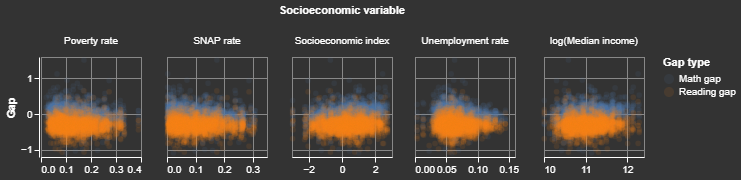

In [31]:
# plot gap against socioeconomic variables by subject for all grades
fig1 = alt.Chart(plot_df).mark_circle(opacity = 0.1).encode(
    y = 'Gap',
    x = alt.X('Measure', scale = alt.Scale(zero = False), title = ''),
    color = 'Gap type'
).properties(
    width = 100,
    height = 100
).facet(
    column = alt.Column('Socioeconomic variable')
).resolve_scale(x = 'independent')

fig1

<!-- BEGIN QUESTION -->

### Question 13: Relationships by grade level

Does the pattern shown in the plot above persist within each grade level? Modify the plot above to show these relationships by grade level: generate a panel of scatterplots of gap against socioeconomic measures by subject, where each column of the panel corresponds to one socioeconomic variable and each row corresponds to one grade level; the result should by a 5x5 panel. Resize the width and height of each facet so that the panel is of reasonable size. Keep a fixed axis scale for the variable of interest, but allow the axis scales for socioeconomic variables to vary independently. Store the plot as `fig2`; display the figure and provide an answer to the question of interest in the text cell.

(*Hint*: you may find it useful to have a look at the [altair documentation on compound charts](https://altair-viz.github.io/user_guide/compound_charts.html), and lab 3, for examples to follow.)

The overall patterns of the plots above persist within each grade level but it seems the higher the grade level, the subject gap seems to decrease, indicating that girls score even higher than boys in the higher grades.

/opt/conda/lib/python3.11/site-packages/altair/utils/core.py:410: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/conda/lib/python3.11/site-packages/altair/utils/core.py:410: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


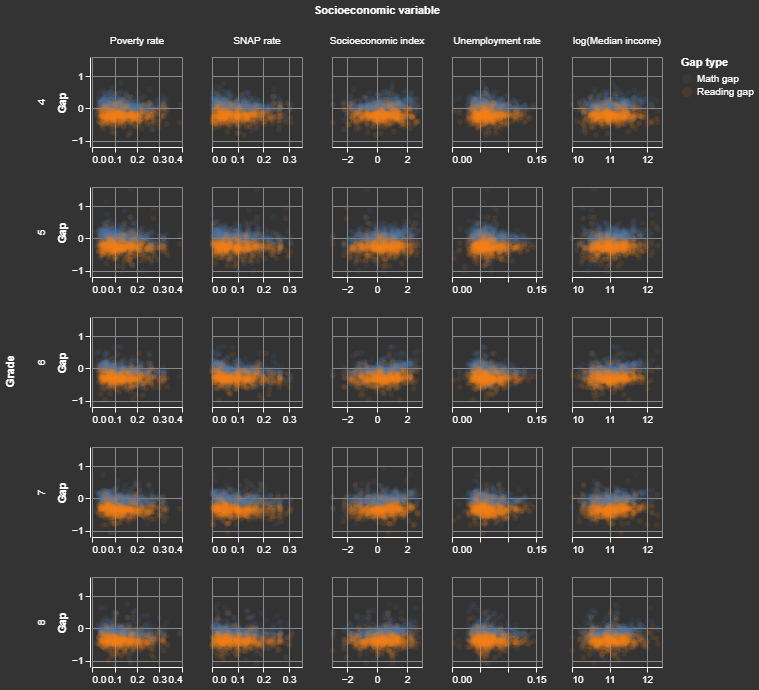

In [32]:
# plotting codes here
fig2 = alt.Chart(plot_df).mark_circle(opacity = 0.1).encode(
    y = 'Gap',
    x = alt.X('Measure', scale = alt.Scale(zero = False), title = ''),
    color = 'Gap type'
).properties(
    width = 90,
    height = 90
).facet(
    row = alt.Row('Grade'),
    column = alt.Column('Socioeconomic variable')
).resolve_scale(x = 'independent')


# display
fig2

<!-- END QUESTION -->

<!-- BEGIN QUESTION -->


### Question 14: Association with grade level

Do gaps shift across grade levels? It's not so easy to tell from the last figure. Construct a 2x5 panel of scatterplots showing estimated achievement gap against each of the 5 socioeconomic variables, with one row per test subject. Display grade level using a color gradient. Store the plot as `fig3`; display the figure and answer the question of interest in a short sentence or two in the text cell provided.

From the graphs below, we can see that the darker points (the higher grades) gravitate more towards the bottom of the plots which implies that as grade level increases, the achievenemnt gap between boys and girls also increases in favor of girls.

/opt/conda/lib/python3.11/site-packages/altair/utils/core.py:410: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)
/opt/conda/lib/python3.11/site-packages/altair/utils/core.py:410: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


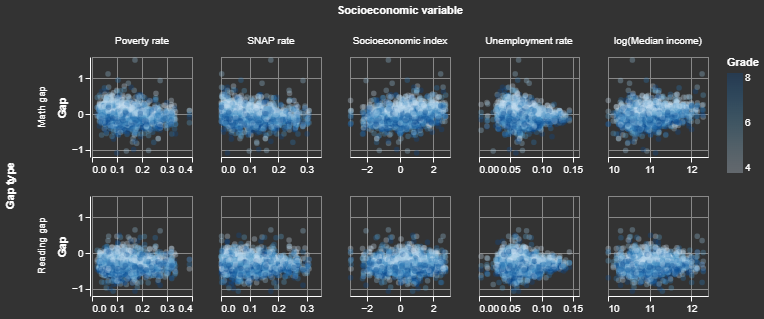

In [33]:
# plotting codes here

fig3 = alt.Chart(plot_df).mark_circle(opacity = 0.3).encode(
    y = 'Gap',
    x = alt.X('Measure', scale = alt.Scale(zero = False), title = ''),
    color = 'Grade'
).properties(
    width = 100,
    height = 100
).facet(
    row = alt.Row('Gap type'),
    column = alt.Column('Socioeconomic variable')
).resolve_scale(x = 'independent')

# display
fig3

<!-- END QUESTION -->

While the magnitude of the achievement gaps seems to depend very slightly on grade level (figure 3), the form of relationship between achievement gap and socioeconomic factors does not differ from grade to grade (figure 2). 

Given that the relationships between achievement gaps and socioeconomic factors don't change drastically across grade levels, it is reasonable to look at the average relationship between estimated achievement gap and median income after aggregating across grade. 

### Question 15: Aggregation across grade levels

Compute the mean estimated achievement gap in each subject across grade levels by district using `District ID` and retain the district-level socioeconomic variables. Store the resulting data frame as `seda_data_agg`. 

*Note*: best practice here would be to aggregate just the test scores by district and then re-merge the result with the district-level socioeconomic variables. However, since the district-level socioeconomic variables do not differ by grade within a district, averaging them across grade levels by district together with the test scores will simply return their unique values; so the aggregation can be applied across *all* columns for a fast-and-loose way to obtain the desired result.

In [34]:
# aggregate across grades
seda_data_agg = seda_data.groupby('District ID').mean(['Math gap', 'Reading gap']).reset_index()

# print first few rows
seda_data_agg.head()

,District ID,log(Median income),Poverty rate,Unemployment rate,SNAP rate,Socioeconomic index,Grade,Math gap,Reading gap
0,600001,11.392048,0.091894,0.048886,0.035165,1.237209,6.0,-0.562855,-0.785321
1,600006,11.607236,0.041418,0.048269,0.028006,1.912972,5.5,0.061163,-0.242572
2,600011,10.704570,0.159981,0.066333,0.102054,-0.478127,6.0,-0.015417,-0.191400
3,600012,10.589787,0.179102,0.059158,0.074903,-0.096379,6.0,NaN,NaN
4,600013,11.399662,0.060338,0.045533,0.035016,1.398133,6.0,0.054454,-0.312638


In [35]:
grader.check("q15")

q15 results: All test cases passed!

### Question 16: Melt aggregated data for plotting

Similar to working with the disaggregated data, it will be helpful for plotting to melt the two gap variables into a single column. Follow the example above at the beginning of this section to melt *only the test score gap columns* (not the district-level variables -- we will not create scatterplot panels as before). Name the new columns `Subject` and `Average estimated gap`; store the resulting data frame as `agg_plot_df` and print the first four rows.

In [36]:
# format for plotting
agg_plot_df = seda_data_agg.melt(
    id_vars = ['District ID', 'log(Median income)', 'Poverty rate', 'Unemployment rate', 'SNAP rate', 'Socioeconomic index'],
    value_vars = ['Math gap', 'Reading gap'],
    var_name = 'Subject',
    value_name = 'Average estimated gap'
)

# print four rows
agg_plot_df.head()

,District ID,log(Median income),Poverty rate,Unemployment rate,SNAP rate,Socioeconomic index,Subject,Average estimated gap
0,600001,11.392048,0.091894,0.048886,0.035165,1.237209,Math gap,-0.562855
1,600006,11.607236,0.041418,0.048269,0.028006,1.912972,Math gap,0.061163
2,600011,10.704570,0.159981,0.066333,0.102054,-0.478127,Math gap,-0.015417
3,600012,10.589787,0.179102,0.059158,0.074903,-0.096379,Math gap,NaN
4,600013,11.399662,0.060338,0.045533,0.035016,1.398133,Math gap,0.054454


In [37]:
grader.check("q16")

q16 results: All test cases passed!

<!-- BEGIN QUESTION -->

### Question 17: District average gaps

Construct a scatterplot of the average estimated gap against log(Median income) by subject for each district and add trend lines (see lab 4). Store the plot as `fig4`. Describe and interpret the plot in a few sentences.


For the math gap plot, as log(median income) increases, the average estimated gap between girls and boys scores in tests also increases. For the Reading plot, it seems as thought the log(median income) has little effect on the average estimated gap.

/opt/conda/lib/python3.11/site-packages/altair/utils/core.py:410: FutureWarning: the convert_dtype parameter is deprecated and will be removed in a future version.  Do ``ser.astype(object).apply()`` instead if you want ``convert_dtype=False``.
  col = df[col_name].apply(to_list_if_array, convert_dtype=False)


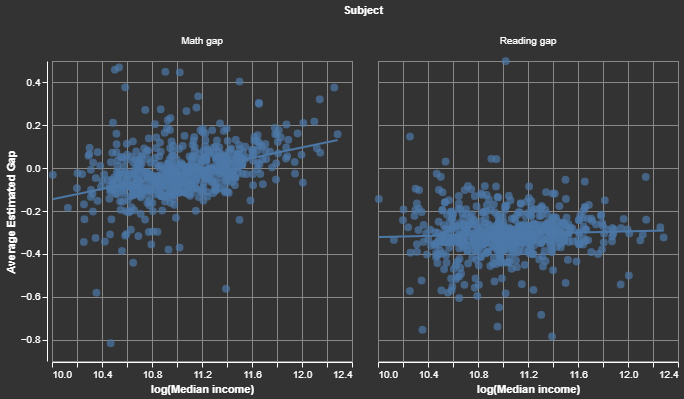

In [38]:
# scatterplot
fig4 = alt.Chart(agg_plot_df).mark_circle(size=60).encode(
    x = alt.X('log(Median income)',scale=alt.Scale(zero=False), title='log(Median income)'),
    y = alt.Y('Average estimated gap', scale=alt.Scale(zero=False), title='Average Estimated Gap')
)
# trend line
trend = fig4.transform_regression('log(Median income)', 'Average estimated gap').mark_line()

# combine layers
fig4 = (fig4 + trend).facet(
    column = 'Subject'
)
#display
fig4

<!-- END QUESTION -->

Now let's try to capture this pattern in *tabular* form. The cell below adds an `Income bracket` variable by cutting the median income into 8 contiguous intervals using `pd.cut()`, and tabulates the average socioeconomic measures and estimated gaps across districts by income bracket. Notice that with respect to the gaps, this displays the pattern that is shown visually in the figures above. 

In [39]:
seda_data_agg['Income bracket'] = pd.cut(np.array(np.e**seda_data_agg['log(Median income)']), 8)
seda_data_agg.groupby('Income bracket').mean().drop(columns = ['District ID', 'log(Median income)'])

/tmp/ipykernel_94/3320431499.py:2: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  seda_data_agg.groupby('Income bracket').mean().drop(columns = ['District ID', 'log(Median income)'])


,Poverty rate,Unemployment rate,SNAP rate,Socioeconomic index,Grade,Math gap,Reading gap
Income bracket,,,,,,,
"(21980.176, 46455.372]",0.194870,0.072689,0.155061,-0.651999,5.994241,-0.070284,-0.309743
"(46455.372, 70736.321]",0.134078,0.063788,0.095303,0.291085,5.978134,-0.034061,-0.315545
"(70736.321, 95017.269]",0.088713,0.052785,0.048242,1.110433,5.944277,0.004239,-0.302114
"(95017.269, 119298.218]",0.064131,0.046848,0.030548,1.640159,5.907738,0.050006,-0.287117
"(119298.218, 143579.167]",0.050315,0.044343,0.011023,2.167272,5.722222,0.090138,-0.289529
"(143579.167, 167860.115]",0.043896,0.042379,0.008451,2.382258,6.000000,0.084683,-0.335975
"(167860.115, 192141.064]",0.040552,0.040120,0.010159,2.652906,5.833333,0.175793,-0.232306
"(192141.064, 216422.013]",0.047097,0.054055,0.002555,2.588499,6.000000,0.267301,-0.299798


### Question 18: Proportion of districts with a math gap

What proportion of districts in each income bracket have an average estimated math achievement gap favoring boys? Answer this question by performing the following steps:

* Append an indicator variable `Math gap favoring boys` to `seda_data_agg` that records whether the average estimated math gap favors boys by more than 0.1 standard deviations relative to the national average.
* Compute the proportion of districts in each income bracket for which the indicator is true: group by bracket and take the mean. Store this as `income_bracket_boys_favored`


In [40]:
# define indicator
seda_data_agg['Math gap favoring boys'] = seda_data_agg['Math gap'] > 0.1

# proportion of districts with gap favoring boys, by income bracket
income_bracket_boys_favored = seda_data_agg.groupby('Income bracket')['Math gap favoring boys'].mean().reset_index()
# print result
print(income_bracket_boys_favored)

             Income bracket  Math gap favoring boys
0    (21980.176, 46455.372]                0.036585
1    (46455.372, 70736.321]                0.061224
2    (70736.321, 95017.269]                0.084337
3   (95017.269, 119298.218]                0.232143
4  (119298.218, 143579.167]                0.388889
5  (143579.167, 167860.115]                0.444444
6  (167860.115, 192141.064]                0.500000
7  (192141.064, 216422.013]                1.000000


/tmp/ipykernel_94/3591293045.py:5: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  income_bracket_boys_favored = seda_data_agg.groupby('Income bracket')['Math gap favoring boys'].mean().reset_index()


In [41]:
grader.check("q18")

q18 results: All test cases passed!

### Question 19: Statewide averages

To wrap up the exploration, calculate a few statewide averages to get a sense of how some of the patterns above compare with the state as a whole.

* (i) Compute the statewide average estimated achievement gaps. Store the result as `state_avg`.
* (ii) Compute the proportion of districts in the state with a math gap favoring boys. Store this result as `math_boys_proportion`
* (iii)  Compute the proportion of districts in the state with a math gap favoring girls. You will need to define a new indicator within `seda_data_agg` to perform this calculation.


In [42]:
# statewide average
state_avg = seda_data_agg[['Math gap','Reading gap']].mean()
# proportion of districts in the state with a math gap favoring boys
#math_boys_proportion = len(agg_plot_df[(agg_plot_df['Subject'] == 'Math gap') & (agg_plot_df['Average estimated gap'] > 0)])/len(agg_plot_df[(agg_plot_df['Subject'] == 'Math gap')])
math_boys_proportion = seda_data_agg['Math gap favoring boys'].mean()
# proportion of districts in the state with a math gap favoring girls
seda_data_agg['Math gap favoring girls'] = seda_data_agg['Math gap'] < -0.1
math_girls_proportion = seda_data_agg['Math gap favoring girls'].mean()

In [43]:
grader.check("q19")

q19 results: All test cases passed!

# Communicating results

Take a moment to review and reflect on your findings and consider what you have learned from the analysis.

<!-- BEGIN QUESTION -->

### Question 20: Summary

Write a brief summary of your exploratory analysis. What have you discovered about educational achievement gaps in California school districts? Aim to answer in 3-5 sentences or less.


From my exploratory analysis, I have discovered that the outdated views that boys constantly out perform girls in tests is clearly wrong from the data that I worked with. Based on plots of standardized score differences between girls and boys, it is likely that there is little to no difference in the performance between genders in specifically math tests. On the other hand, data shows that on average, there is a significant difference in performance for reading tests favoring girls. Some other important findings are that there are other factors that influence the difference in test scores between the genders such as income level and grade. Our data shows that the higher the income level for a district, the higher the chance that there is a math gap favoring boys and the higher the grade level, the more the reading gap favors girls.

<!-- END QUESTION -->

# Submission


1. Save the notebook. 
2. Restart the kernel and run all cells. (**CAUTION**: if your notebook is not saved, you will lose your work.)
3. Carefully look through your notebook and verify that all computations execute correctly and all graphics are displayed clearly. You should see **no errors**; if there are any errors, make sure to correct them before you submit the notebook.
4. Download the notebook as an `.ipynb` file. This is your backup copy.
5. Export the notebook as PDF and upload to Gradescope.

---

To double-check your work, the cell below will rerun all of the autograder tests.

In [44]:
grader.check_all()

q10 results: All test cases passed!

q11 results: All test cases passed!

q15 results: All test cases passed!

q16 results: All test cases passed!

q18 results: All test cases passed!

q19 results: All test cases passed!

q3 results: All test cases passed!

q5 results: All test cases passed!

q6 results: All test cases passed!

q7 results: All test cases passed!

q8 results: All test cases passed!

q9 results: All test cases passed!